<a href="https://colab.research.google.com/github/DilshodbekMX/GoogleColab/blob/main/ObjectDetectionPipeline.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Step 1: Mount Google Drive ##

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

In [ ]:
## Run this if you want to access models from google drive
import os
print(os.getcwd())




C:\Users\DilshodbekMX\Desktop


## Step 2: Install Dependencies

In [ ]:
!pip install -U --pre tensorflow

In [ ]:
import os
import pathlib
os.chdir('gdrive/My Drive/')
print(os.getcwd())

# Clone the tensorflow models repository if it doesn't already exist
if "models" in pathlib.Path.cwd().parts:
  while "models" in pathlib.Path.cwd().parts:
    os.chdir('..')
elif not pathlib.Path('models').exists():
  !git clone --depth 1 https://github.com/tensorflow/models

/content/gdrive/My Drive
Cloning into 'models'...
remote: Enumerating objects: 3334, done.
remote: Counting objects: 100% (3334/3334), done.
remote: Compressing objects: 100% (2759/2759), done.
remote: Total 3334 (delta 886), reused 1389 (delta 525), pack-reused 0
Receiving objects: 100% (3334/3334), 34.31 MiB | 8.58 MiB/s, done.
Resolving deltas: 100% (886/886), done.
Checking out files: 100% (3031/3031), done.


In [ ]:
# Object detection API
%%bash
cd models/research/
protoc object_detection/protos/*.proto --python_out=.
cp object_detection/packages/tf2/setup.py .
python -m pip install .

Processing /content/gdrive/My Drive/models/research
  Created wheel for object-detection: filename=object_detection-0.1-py3-none-any.whl size=1691106 sha256=80a40fd358dea6d1e2856d4dd6d1294d9bee89485719502f5430af7b598e84e2
  Stored in directory: /tmp/pip-ephem-wheel-cache-bta2bolh/wheels/d1/31/0f/56b714df653103ae59087f5c5de3f254ddfd3943f31b42a5cc
  Created wheel for py-cpuinfo: filename=py_cpuinfo-8.0.0-py3-none-any.whl size=22257 sha256=ffb7409157a5c8a1948d03abc7f153cdea4ce36ea916c899244bca25827da688
  Stored in directory: /root/.cache/pip/wheels/d2/f1/1f/041add21dc9c4220157f1bd2bd6afe1f1a49524c3396b94401
  Created wheel for dill: filename=dill-0.3.1.1-py3-none-any.whl size=78544 sha256=63886526598c17e0d328ee45035c2731cde112188ac0bd2dbc7d7d713280b34b
  Stored in directory: /root/.cache/pip/wheels/a4/61/fd/c57e374e580aa78a45ed78d5859b3a44436af17e22ca53284f
  Created wheel for avro-python3: filename=avro_python3-1.10.2-py3-none-any.whl size=44010 sha256=8a795afdf4e96b7cececebc0ba7f8fc284

  DEPRECATION: A future pip version will change local packages to be built in-place without first copying to a temporary directory. We recommend you use --use-feature=in-tree-build to test your packages with this new behavior before it becomes the default.
   pip 21.3 will remove support for this functionality. You can find discussion regarding this at https://github.com/pypa/pip/issues/7555.
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
multiprocess 0.70.12.2 requires dill>=0.3.4, but you have dill 0.3.1.1 which is incompatible.
gym 0.17.3 requires cloudpickle<1.7.0,>=1.2.0, but you have cloudpickle 2.0.0 which is incompatible.
google-colab 1.0.0 requires requests~=2.23.0, but you have requests 2.27.1 which is incompatible.
datascience 0.10.6 requires folium==0.2.1, but you have folium 0.8.3 which is incompatible.


In [ ]:
#run model builder test
!python /content/gdrive/"My Drive"/models/research/object_detection/builders/model_builder_tf2_test.py

2020-09-07 10:44:58.911391: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
Running tests under Python 3.6.9: /usr/bin/python3
[ RUN      ] ModelBuilderTF2Test.test_create_center_net_model
2020-09-07 10:45:01.319406: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcuda.so.1
2020-09-07 10:45:01.373029: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:982] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2020-09-07 10:45:01.373773: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1716] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla P100-PCIE-16GB computeCapability: 6.0
coreClock: 1.3285GHz coreCount: 56 deviceMemorySize: 15.90GiB deviceMemoryBandwidth: 681.88GiB/s
2020-09-07 10:45:01.373821: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] 

## Step 3: Prepare Image Data ##


In [ ]:
## To be done (git clone lableimg, label the data and convert to xml)

In [ ]:
print(os.getcwd())
os.chdir('models')
print(os.getcwd())

/content/gdrive/My Drive
/content/gdrive/My Drive/models


In [ ]:
import os
import glob
import pandas as pd
import xml.etree.ElementTree as ET

def xml_to_csv(path):
    xml_list = []
    classes_names = []

    for xml_file in glob.glob(path + '/*.xml'):
        tree = ET.parse(xml_file)
        root = tree.getroot()
        for member in root.findall('object'):
            value = (root.find('filename').text,
                     int(root.find('size')[0].text),
                     int(root.find('size')[1].text),
                     member[0].text,
                     int(member[4][0].text),
                     int(member[4][1].text),
                     int(member[4][2].text),
                     int(member[4][3].text)
                     )
            xml_list.append(value)
    column_name = ['filename', 'width', 'height', 'class', 'xmin', 'ymin', 'xmax', 'ymax']
    xml_df = pd.DataFrame(xml_list, columns=column_name)
    classes_names = list(set(classes_names))
    classes_names.sort()

    return xml_df, classes_names

def main():
    for directory in ['train', 'test']:
        print(directory)
        image_path = os.path.join(os.getcwd(), 'research/object_detection/images/{}'.format(directory))
        xml_df, classes = xml_to_csv(image_path)
        print(os.getcwd())
        xml_df.to_csv('research/object_detection/data/{}_labels.csv'.format(directory), index=None)
        print('Successfully converted xml to csv.')


main()

train
/content/gdrive/My Drive/models
Successfully converted xml to csv.
test
/content/gdrive/My Drive/models
Successfully converted xml to csv.


In [ ]:
# Convert csv to tf record files - To switch to a code based version so that the sys.exit dont take place.

from __future__ import division
from __future__ import print_function
from __future__ import absolute_import

import os
import io
import pandas as pd
import tensorflow as tf

from PIL import Image
from object_detection.utils import dataset_util
from collections import namedtuple, OrderedDict

"""
Usage:
  # From tensorflow/models/

  # Create train data:
  python Generate_TF_Records.py --csv_input=data/train_labels.csv  --output_path=train.record

  # Create test data:
  python generate_tfrecord.py --csv_input=data/test_labels.csv  --output_path=test.record

"""


#flags = tf.compat.v1.flags
#flags.DEFINE_string('csv_input', '', 'Path to the CSV input')
#flags.DEFINE_string('output_path', '', 'Path to output TFRecord')
#flags.DEFINE_string('image_dir', '', 'Path to images')
#LAGS = flags.FLAGS

# TO-DO replace this with label map

def class_text_to_int(row_label):
    if row_label == 'tree':
        return 1
    else:
        None

def split(df, group):
    data = namedtuple('data', ['filename', 'object'])
    gb = df.groupby(group)
    return [data(filename, gb.get_group(x)) for filename, x in zip(gb.groups.keys(), gb.groups)]

def create_tf_example(group, path):
    print(path)
    print(group.filename)
    with tf.compat.v1.gfile.GFile(os.path.join(path, '{}'.format(group.filename)), 'rb') as fid:
        encoded_jpg = fid.read()
    encoded_jpg_io = io.BytesIO(encoded_jpg)
    image = Image.open(encoded_jpg_io)
    width, height = image.size

    filename = group.filename.encode('utf8')
    image_format = b'jpg'
    xmins = []
    xmaxs = []
    ymins = []
    ymaxs = []
    classes_text = []
    classes = []

    for index, row in group.object.iterrows():
        xmins.append(row['xmin'] / width)
        xmaxs.append(row['xmax'] / width)
        ymins.append(row['ymin'] / height)
        ymaxs.append(row['ymax'] / height)
        classes_text.append(row['class'].encode('utf8'))
        classes.append(class_text_to_int(row['class']))

    tf_example = tf.train.Example(features=tf.train.Features(feature={
        'image/height': dataset_util.int64_feature(height),
        'image/width': dataset_util.int64_feature(width),
        'image/filename': dataset_util.bytes_feature(filename),
        'image/source_id': dataset_util.bytes_feature(filename),
        'image/encoded': dataset_util.bytes_feature(encoded_jpg),
        'image/format': dataset_util.bytes_feature(image_format),
        'image/object/bbox/xmin': dataset_util.float_list_feature(xmins),
        'image/object/bbox/xmax': dataset_util.float_list_feature(xmaxs),
        'image/object/bbox/ymin': dataset_util.float_list_feature(ymins),
        'image/object/bbox/ymax': dataset_util.float_list_feature(ymaxs),
        'image/object/class/text': dataset_util.bytes_list_feature(classes_text),
        'image/object/class/label': dataset_util.int64_list_feature(classes),
    }))

    return tf_example

def main(_):
    for directory in ['train', 'test']:
      output_path = os.path.join(os.getcwd(), 'research/object_detection/data/{}.record'.format(directory))
      print(output_path)
      input_path = os.path.join(os.getcwd(), 'research/object_detection/data/{}_labels.csv'.format(directory))
      print(input_path)
      writer = tf.io.TFRecordWriter(output_path)
      print(os.getcwd())
      path = os.path.join(os.getcwd(), 'research/object_detection/images/{}'.format(directory))
      print(path)
      examples = pd.read_csv(input_path)
      grouped = split(examples, 'filename')
      for group in grouped:
          tf_example = create_tf_example(group, path)
          writer.write(tf_example.SerializeToString())

      writer.close()
      #output_path = os.path.join(os.getcwd(), FLAGS.output_path)
      print('Successfully created the TFRecords: {}'.format(output_path))

if __name__ == '__main__':
    tf.compat.v1.app.run()

/content/gdrive/My Drive/models/research/object_detection/data/train.record
/content/gdrive/My Drive/models/research/object_detection/data/train_labels.csv
/content/gdrive/My Drive/models
/content/gdrive/My Drive/models/research/object_detection/images/train
/content/gdrive/My Drive/models/research/object_detection/images/train
0.09146200_1567071232_trees-gettyimages-.jpg
/content/gdrive/My Drive/models/research/object_detection/images/train
1000x-1.jpg
/content/gdrive/My Drive/models/research/object_detection/images/train
107667228_beech-tree-NEWS-xlarge_trans_NvBQzQNjv4BqplGOf-dgG3z4gg9owgQTXEmhb5tXCQRHAvHRWfzHzHk.jpg
/content/gdrive/My Drive/models/research/object_detection/images/train
1200px-Big_Banyan_Tree_at_Bangalore.jpg
/content/gdrive/My Drive/models/research/object_detection/images/train
1452646441575.jpeg
/content/gdrive/My Drive/models/research/object_detection/images/train
220px-1859-Martinique.web.jpg
/content/gdrive/My Drive/models/research/object_detection/images/train

SystemExit: ignored

/usr/local/lib/python3.6/dist-packages/IPython/core/interactiveshell.py:2890: UserWarning: To exit: use 'exit', 'quit', or Ctrl-D.
  warn("To exit: use 'exit', 'quit', or Ctrl-D.", stacklevel=1)


In [ ]:
# Creating the `label_map.pbtxt` file - For now done separately but need to be integrated to colab. Will need to modify code for this.

In [ ]:
#checking the pbtxt file
import os
os.chdir('/content/gdrive/My Drive/models/research/object_detection/data')
!cat object-detection.pbtxt
os.chdir('/content/gdrive/My Drive/models/research/object_detection')
print(os.getcwd())
labelmap_path = os.path.join(os.getcwd(), 'data/object-detection.pbtxt')
train_record_path = os.path.join(os.getcwd(), 'data/train.record')
test_record_path = os.path.join(os.getcwd(), 'data/test.record')

item {
  id: 1
  name: 'tree'
}
/content/gdrive/My Drive/models/research/object_detection


## Step 4: Configuring training

Now that the data is ready it's time to create a training configuration. In this notebook I'm making use of EfficientDet, but you can replace it with any model available in the [Tensorflow 2 Detection Model Zoo](https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/tf2_detection_zoo.md).

In [ ]:
batch_size = 16
num_steps = 80000
num_eval_steps = 1000

In [ ]:
!wget http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz
!tar -xf ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz

--2020-09-07 00:20:44--  http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 74.125.197.128, 2607:f8b0:400e:c03::80
Connecting to download.tensorflow.org (download.tensorflow.org)|74.125.197.128|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 20515344 (20M) [application/x-tar]
Saving to: ‘ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz.1’

ssd_mobilenet_v2_fp 100%[===================>]  19.56M  76.4MB/s    in 0.3s    

2020-09-07 00:20:45 (76.4 MB/s) - ‘ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz.1’ saved [20515344/20515344]



In [ ]:
fine_tune_checkpoint = 'ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/checkpoint/ckpt-0'

In [ ]:
!wget https://raw.githubusercontent.com/tensorflow/models/master/research/object_detection/configs/tf2/ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.config
print(os.getcwd())

base_config_path = 'ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.config'

--2020-09-07 00:20:50--  https://raw.githubusercontent.com/tensorflow/models/master/research/object_detection/configs/tf2/ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.config
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 4684 (4.6K) [text/plain]
Saving to: ‘ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.config.1’

ssd_mobilenet_v2_fp 100%[===================>]   4.57K  --.-KB/s    in 0.001s  

2020-09-07 00:20:51 (4.88 MB/s) - ‘ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.config.1’ saved [4684/4684]

/content/gdrive/My Drive/models/research/object_detection


In [ ]:
# edit configuration file (from https://colab.research.google.com/drive/1sLqFKVV94wm-lglFq_0kGo2ciM0kecWD)

import re

with open(base_config_path) as f:
    config = f.read()

with open('model_config.config', 'w') as f:

  # Set labelmap path
  config = re.sub('label_map_path: ".*?"',
             'label_map_path: "{}"'.format(labelmap_path), config)

  # Set fine_tune_checkpoint path
  config = re.sub('fine_tune_checkpoint: ".*?"',
                  'fine_tune_checkpoint: "{}"'.format(fine_tune_checkpoint), config)

  # Set train tf-record file path
  config = re.sub('(input_path: ".*?)(PATH_TO_BE_CONFIGURED/train)(.*?")',
                  'input_path: "{}"'.format(train_record_path), config)

  # Set test tf-record file path
  config = re.sub('(input_path: ".*?)(PATH_TO_BE_CONFIGURED/val)(.*?")',
                  'input_path: "{}"'.format(test_record_path), config)

  # Set number of classes.
  config = re.sub('num_classes: [0-9]+',
                  'num_classes: {}'.format(1), config)

  # Set batch size
  config = re.sub('batch_size: [0-9]+',
                  'batch_size: {}'.format(batch_size), config)

  # Set training steps
  config = re.sub('num_steps: [0-9]+',
                  'num_steps: {}'.format(num_steps), config)

  # Set fine-tune checkpoint type to detection
  config = re.sub('fine_tune_checkpoint_type: "classification"',
             'fine_tune_checkpoint_type: "{}"'.format('detection'), config)

  f.write(config)

In [ ]:
%cat model_config.config

# SSD with Mobilenet v2 FPN-lite (go/fpn-lite) feature extractor, shared box
# predictor and focal loss (a mobile version of Retinanet).
# Retinanet: see Lin et al, https://arxiv.org/abs/1708.02002
# Trained on COCO, initialized from Imagenet classification checkpoint
# Train on TPU-8
#
# Achieves 22.2 mAP on COCO17 Val

model {
  ssd {
    inplace_batchnorm_update: true
    freeze_batchnorm: false
    num_classes: 1
    box_coder {
      faster_rcnn_box_coder {
        y_scale: 10.0
        x_scale: 10.0
        height_scale: 5.0
        width_scale: 5.0
      }
    }
    matcher {
      argmax_matcher {
        matched_threshold: 0.5
        unmatched_threshold: 0.5
        ignore_thresholds: false
        negatives_lower_than_unmatched: true
        force_match_for_each_row: true
        use_matmul_gather: true
      }
    }
    similarity_calculator {
      iou_similarity {
      }
    }
    encode_background_as_zeros: true
    anchor_generator {
      multiscale_anchor_generator {

In [ ]:
print(os.getcwd())
!ls
os.chdir('gdrive/My Drive/models/research/object_detection')
model_dir = 'training/'
pipeline_config_path = 'model_config.config'

/content
gdrive	sample_data


### Train Model

In [ ]:
print(os.getcwd())
!ls

/content
sample_data


In [ ]:
!python model_main_tf2.py \
    --pipeline_config_path={pipeline_config_path} \
    --model_dir={model_dir} \
    --alsologtostderr \
    --num_train_steps={num_steps} \
    --sample_1_of_n_eval_examples=1 \
    --num_eval_steps={num_eval_steps}

2020-09-07 03:59:10.812437: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
2020-09-07 03:59:12.843864: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcuda.so.1
2020-09-07 03:59:12.848381: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:982] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2020-09-07 03:59:12.848881: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1716] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla T4 computeCapability: 7.5
coreClock: 1.59GHz coreCount: 40 deviceMemorySize: 14.73GiB deviceMemoryBandwidth: 298.08GiB/s
2020-09-07 03:59:12.848912: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
2020-09-07 03:59:12.850836: I tensorflow/stream_executor/platform/default

In [ ]:
import os
print(os.getcwd())
%load_ext tensorboard
%tensorboard --logdir 'training/train'

/content


Launching TensorBoard...

### Export model inference graph

In [ ]:
output_directory = 'inference_graph'
print(model_dir)
print(output_directory)
print(pipeline_config_path)

training/
inference_graph
model_config.config


In [ ]:
!python exporter_main_v2.py \
    --trained_checkpoint_dir {model_dir} \
    --output_directory {output_directory} \
    --pipeline_config_path {pipeline_config_path}

2020-09-07 10:15:48.762471: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
Traceback (most recent call last):
  File "exporter_main_v2.py", line 100, in <module>
    from object_detection import exporter_lib_v2
ModuleNotFoundError: No module named 'object_detection'


## Step 5: Test the Model

In [ ]:
import io
import os
import scipy.misc
import numpy as np
import six
import time
import glob
from IPython.display import display

from six import BytesIO

import matplotlib
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw, ImageFont

import tensorflow as tf
from object_detection.utils import ops as utils_ops
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util

%matplotlib inline

In [ ]:
print(os.getcwd())

/content/gdrive/My Drive/models/research/object_detection


In [ ]:
def load_image_into_numpy_array(path):
  """Load an image from file into a numpy array.

  Puts image into numpy array to feed into tensorflow graph.
  Note that by convention we put it into a numpy array with shape
  (height, width, channels), where channels=3 for RGB.

  Args:
    path: a file path (this can be local or on colossus)

  Returns:
    uint8 numpy array with shape (img_height, img_width, 3)
  """
  img_data = tf.io.gfile.GFile(path, 'rb').read()
  image = Image.open(BytesIO(img_data))
  (im_width, im_height) = image.size
  return np.array(image.getdata()).reshape(
      (im_height, im_width, 3)).astype(np.uint8)

In [ ]:
print(labelmap_path)

/content/gdrive/My Drive/models/research/object_detection/data/object-detection.pbtxt


In [ ]:
category_index = label_map_util.create_category_index_from_labelmap(labelmap_path, use_display_name=True)

In [ ]:
tf.keras.backend.clear_session()
model = tf.saved_model.load(f'{output_directory}/saved_model')
print(model)

<tensorflow.python.saved_model.load.Loader._recreate_base_user_object.<locals>._UserObject object at 0x7f16998142b0>


In [ ]:
def run_inference_for_single_image(model, image):
  image = np.asarray(image)
  # The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
  input_tensor = tf.convert_to_tensor(image)
  # The model expects a batch of images, so add an axis with `tf.newaxis`.
  input_tensor = input_tensor[tf.newaxis,...]

  # Run inference
  model_fn = model.signatures['serving_default']
  output_dict = model_fn(input_tensor)

  # All outputs are batches tensors.
  # Convert to numpy arrays, and take index [0] to remove the batch dimension.
  # We're only interested in the first num_detections.
  num_detections = int(output_dict.pop('num_detections'))
  output_dict = {key:value[0, :num_detections].numpy()
                 for key,value in output_dict.items()}
  output_dict['num_detections'] = num_detections

  # detection_classes should be ints.
  output_dict['detection_classes'] = output_dict['detection_classes'].astype(np.int64)

  # Handle models with masks:
  if 'detection_masks' in output_dict:
    # Reframe the the bbox mask to the image size.
    detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
              output_dict['detection_masks'], output_dict['detection_boxes'],
               image.shape[0], image.shape[1])
    detection_masks_reframed = tf.cast(detection_masks_reframed > 0.5,
                                       tf.uint8)
    output_dict['detection_masks_reframed'] = detection_masks_reframed.numpy()

  return output_dict

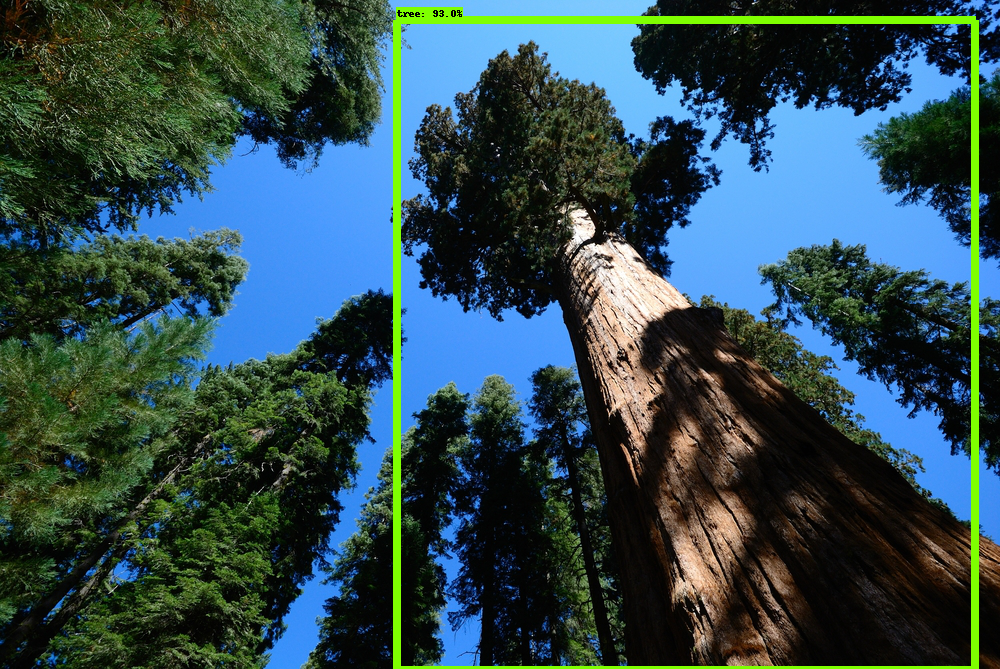

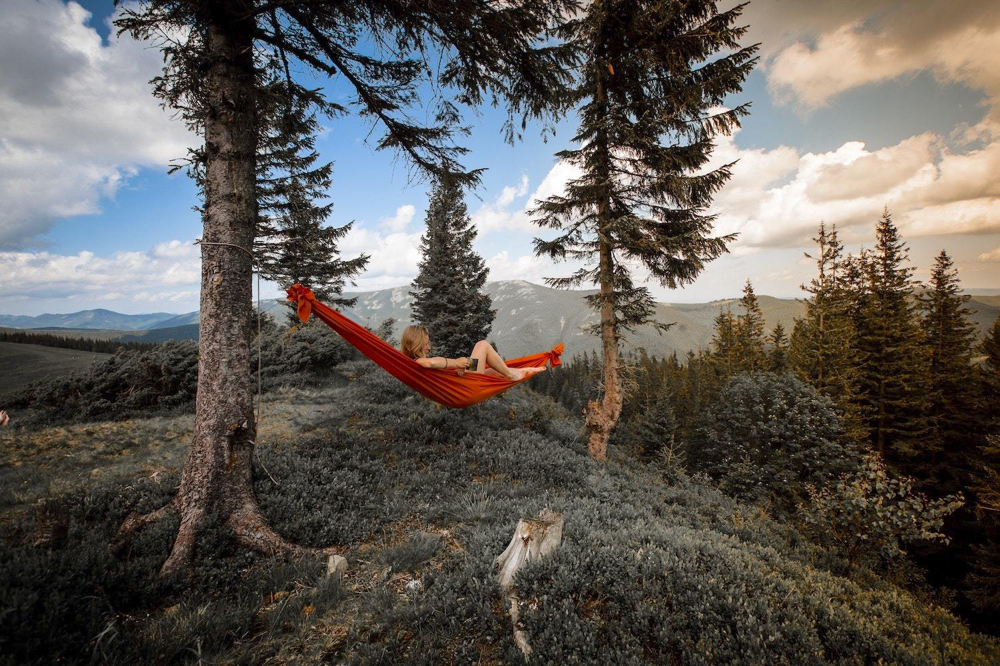

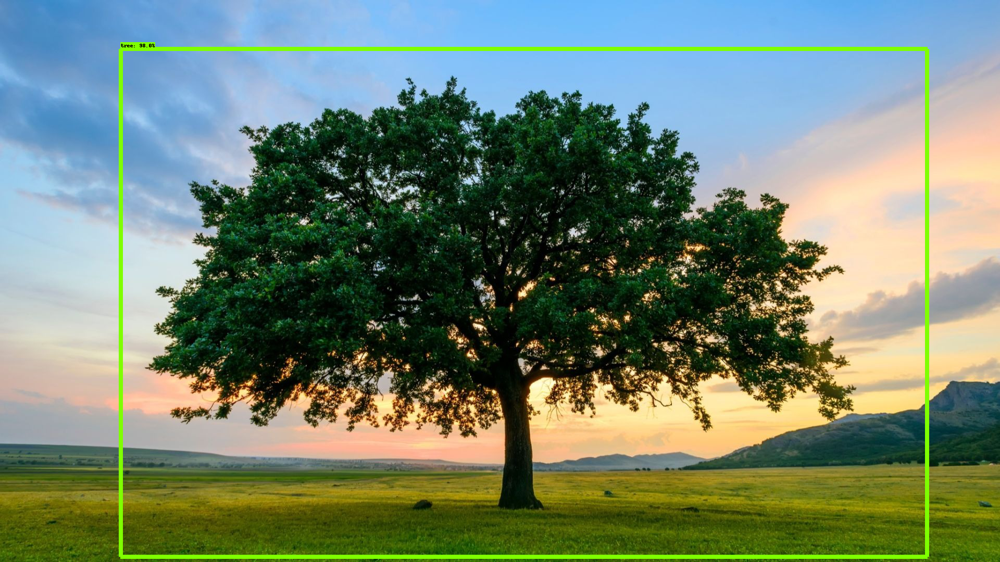

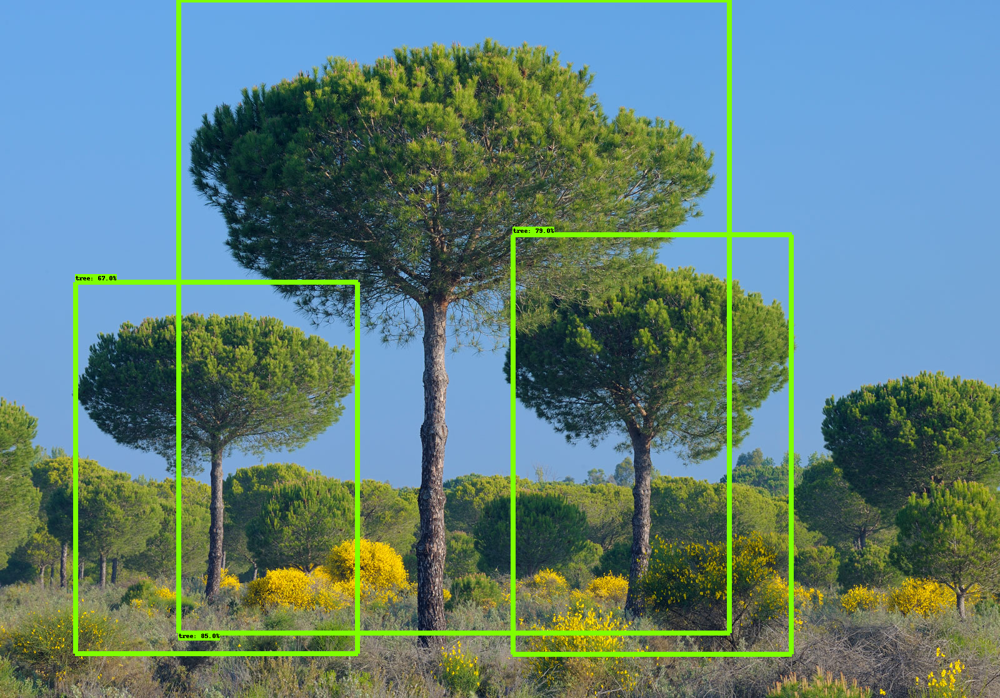

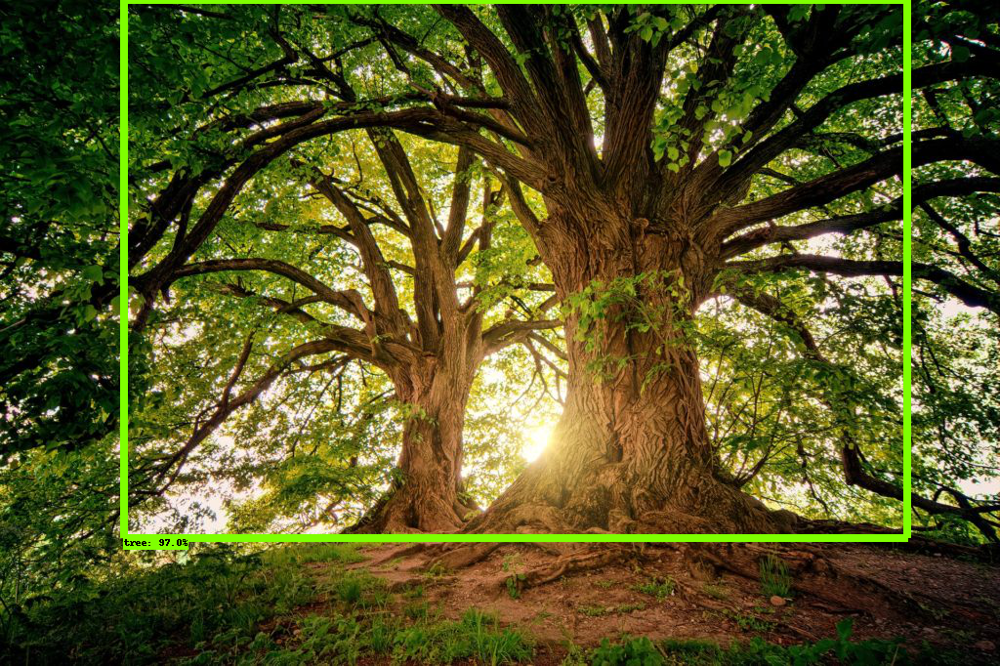

...

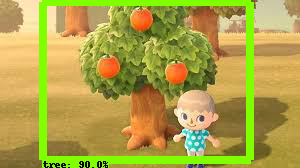

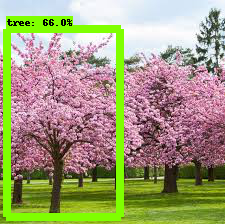

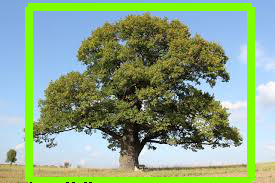

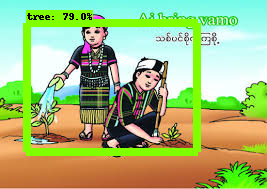

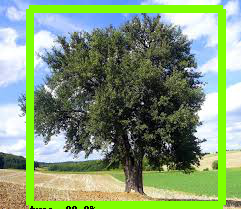

ValueError: ignored

In [ ]:
for image_path in glob.glob('images/test/*.jpg'):
  image_np = load_image_into_numpy_array(image_path)
  output_dict = run_inference_for_single_image(model, image_np)
  vis_util.visualize_boxes_and_labels_on_image_array(
      image_np,
      output_dict['detection_boxes'],
      output_dict['detection_classes'],
      output_dict['detection_scores'],
      category_index,
      instance_masks=output_dict.get('detection_masks_reframed', None),
      use_normalized_coordinates=True,
      line_thickness=8)
  display(Image.fromarray(image_np))